In [1]:
versioninfo()
using LinearAlgebra

Julia Version 1.0.2
Commit d789231e99 (2018-11-08 20:11 UTC)
Platform Info:
  OS: Linux (x86_64-pc-linux-gnu)
  CPU: Intel(R) Core(TM) i5-2500K CPU @ 3.30GHz
  WORD_SIZE: 64
  LIBM: libopenlibm
  LLVM: libLLVM-6.0.0 (ORCJIT, sandybridge)


In [2]:
using Plots; gr()

Plots.GRBackend()

In [3]:
using Distributions

In [100]:
H = 10000

10000

In [101]:
omega = 10.0
sigma = 10.0
sigma_v = omega / sqrt(H)
d0 = Normal(0.0, sigma)
d1 = Normal(0.0, sigma_v)

Normal{Float64}(μ=0.0, σ=0.1)

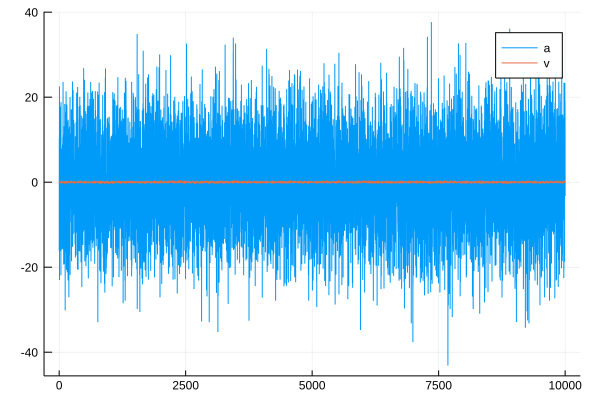

In [102]:
a = rand(d0, H);
u = rand(d0, H);
b = rand(d0);
v = rand(d1, H);
plot([a, v], labels=["a", "v"])

In [103]:
# c is the switching threshold of the input to the hidden node.
# when a and u are sampled from gaussian distribution, their ratio follows Cauchy distribution.
c = a./u
histogram(c)

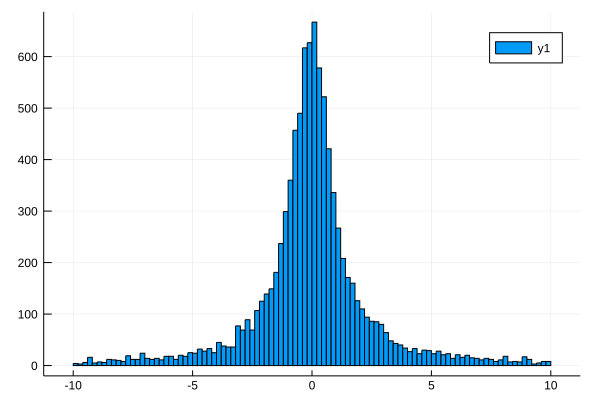

In [104]:
# magnify the above distribution near the peak.
c1 = [y for y in c if -10.0 <= y <= 10.0]
histogram(c1)
#savefig("cauchy-magnified-H10000.png")

In [105]:
# two kinds of hidden layers, smooth and discrete.
h1(x) = tanh.(a + u * x)
h2(x) = sign.(a + u * x)

h2 (generic function with 1 method)

In [106]:
# output calculated with two types of hidden nodes above.
f1(x) = b + dot(v, h1(x))
f2(x) = b + dot(v, h2(x))

f2 (generic function with 1 method)

In [107]:
# test the sampled function againt the input in this range.
x = -5:0.01:5

-5.0:0.01:5.0

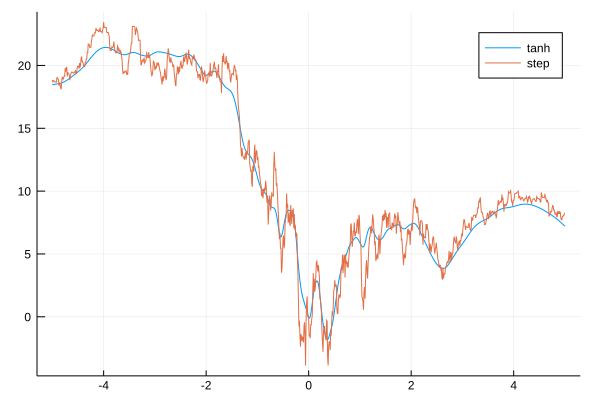

In [108]:
# one typical outcome function sampled from the prior
plot(x, [f1.(x), f2.(x)], labels=["tanh", "step"])

In [109]:
savefig("gaussian_prior_H10000.png")

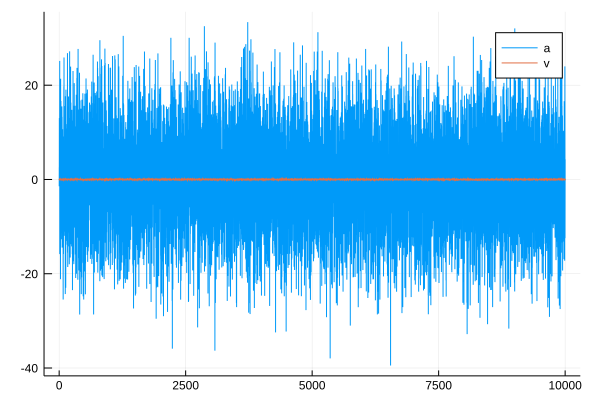

In [110]:
# test two dimensional network
a = rand(d0, H);
u = rand(d0, H, 2);
b = rand(d0);
v = rand(d1, H);
plot([a, v], labels=["a", "v"])

In [111]:
X = [1.0; 2.0]
u * X

10000-element Array{Float64,1}:
  16.339907610065538 
   1.2542045084831974
  -0.994238531619192 
 -15.651351813893312 
 -28.502604780896473 
  -4.850363487809275 
 -17.16219561688248  
  13.361632983755978 
   5.271748437317903 
   4.376697164031231 
   6.157990736662432 
 -19.324847572955353 
 -14.101599505570302 
   ⋮                 
   4.86557743022113  
  -7.279345515798069 
 -33.51702814579323  
  14.654097547349988 
 -12.77872332569575  
 -40.4707325325751   
 -13.883747203036789 
 -18.047645835482697 
 -36.33361283085453  
 -15.59615334416057  
 -38.12398228988268  
   8.03332871026099  

In [112]:
u

10000×2 Array{Float64,2}:
 -11.3547     13.8473  
   6.9751     -2.86045 
  -3.50671     1.25624 
  -1.60934    -7.021   
 -14.3763     -7.06314 
 -13.3226      4.2361  
   0.203177   -8.68269 
   2.34791     5.50686 
  -1.11995     3.19585 
  10.518      -3.07063 
  -7.33565     6.74682 
 -10.2432     -4.54081 
  -1.85853    -6.12153 
   ⋮                   
  10.6314     -2.8829  
  -7.71987     0.220263
  16.1013    -24.8092  
   0.476018    7.08904 
   3.39382    -8.08627 
   3.85528   -22.163   
   1.88873    -7.88624 
   4.34664   -11.1971  
   1.12432   -18.729   
  -4.56933    -5.51341 
  -6.72305   -15.7005  
  -3.53491     5.78412 

In [113]:
h1(X) = tanh.(a + u * X)
h2(X) = sign.(a + u * X)
X = [1; 2]
h1(X)

10000-element Array{Float64,1}:
  0.9999999999997726
  0.9990860965130312
  0.5323283149698839
 -0.9895249524909877
 -1.0               
 -0.9556608578946668
 -0.9999999966419528
  1.0               
  0.9999999998842841
  0.9999999999999267
  1.0               
 -1.0               
  0.9055989657876886
  ⋮                 
  1.0               
 -0.999999999055492 
 -1.0               
  0.9999999999215025
 -0.9999924528182595
 -1.0               
  0.9999999966784987
 -0.9999999999999998
 -1.0               
 -1.0               
 -1.0               
  0.9999999999600704

In [114]:
# output calculated with two types of hidden nodes above.
f1(X) = b + dot(v, h1(X))
f2(X) = b + dot(v, h2(X))
f1(X)

0.3201153604980842

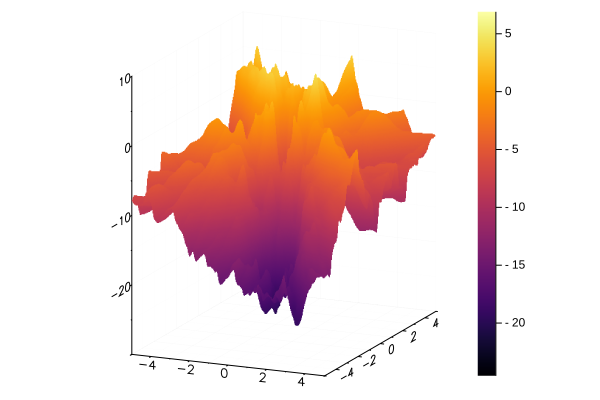

In [115]:
x = y = -5:0.01:5
pf1(x, y) = f1([x;y])
plot(x, y, pf1, st=[:surface])

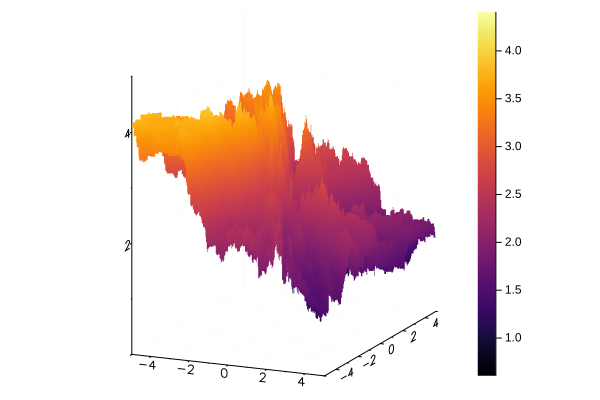

In [99]:
pf2(x, y) = f2([x;y])
plot(x, y, pf2, st=[:surface])